# Big Mobility Data Analytics - Task

Objective:  
Date: February 20, 2023  
Author: Chirag Khatri ckhatri@usc.edu  

## Importing libraries

In [115]:
import json
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import requests

## Reading data

In [3]:
nyctrips = pd.read_csv("./data/nyctripsdata.csv")
print(nyctrips.info())
nyctrips.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 97986 entries, 0 to 97985
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   VendorID               97986 non-null  int64  
 1   tpep_pickup_datetime   97986 non-null  object 
 2   tpep_dropoff_datetime  97986 non-null  object 
 3   passenger_count        97986 non-null  int64  
 4   trip_distance          97986 non-null  float64
 5   pickup_longitude       97986 non-null  float64
 6   pickup_latitude        97986 non-null  float64
 7   dropoff_longitude      97986 non-null  float64
 8   dropoff_latitude       97986 non-null  float64
 9   fare_amount            97986 non-null  float64
 10  tip_amount             97986 non-null  float64
 11  total_amount           97986 non-null  float64
dtypes: float64(8), int64(2), object(2)
memory usage: 9.0+ MB
None


,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,fare_amount,tip_amount,total_amount
0,2,2015-01-15 19:05:39 +00:00,2015-01-15 19:23:42 +00:00,1,1.59,-73.993896,40.750111,-73.974785,40.750618,12.0,3.25,17.05
1,2,2015-01-15 19:05:39 +00:00,2015-01-15 19:32:00 +00:00,1,2.38,-73.976425,40.739811,-73.983978,40.757889,16.5,4.38,22.68
2,2,2015-01-15 19:05:40 +00:00,2015-01-15 19:21:00 +00:00,5,2.83,-73.968704,40.754246,-73.955124,40.786858,12.5,0.00,14.30
3,2,2015-01-15 19:05:40 +00:00,2015-01-15 19:28:18 +00:00,5,8.33,-73.863060,40.769581,-73.952713,40.785782,26.0,8.08,41.21
4,2,2015-01-15 19:05:41 +00:00,2015-01-15 19:20:36 +00:00,1,2.37,-73.945541,40.779423,-73.980850,40.786083,11.5,0.00,13.30


In [4]:
nycinspections = pd.read_csv("./data/DOHMH_New_York_City_Restaurant_Inspection_Results.csv")
print(nycinspections.info())
nycinspections.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 399918 entries, 0 to 399917
Data columns (total 18 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   CAMIS                  399918 non-null  int64  
 1   DBA                    399559 non-null  object 
 2   BORO                   399918 non-null  object 
 3   BUILDING               399809 non-null  object 
 4   STREET                 399909 non-null  object 
 5   ZIPCODE                399909 non-null  float64
 6   PHONE                  399913 non-null  object 
 7   CUISINE DESCRIPTION    399918 non-null  object 
 8   INSPECTION DATE        399918 non-null  object 
 9   ACTION                 398783 non-null  object 
 10  VIOLATION CODE         393414 non-null  object 
 11  VIOLATION DESCRIPTION  392939 non-null  object 
 12  CRITICAL FLAG          399918 non-null  object 
 13  SCORE                  376704 non-null  float64
 14  GRADE                  195413 non-nu

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,GRADE DATE,RECORD DATE,INSPECTION TYPE
0,40511702,NOTARO RESTAURANT,MANHATTAN,635,SECOND AVENUE,10016.0,2126863400,Italian,06/15/2015,Violations were cited in the following area(s).,02B,Hot food item not held at or above 140Âº F.,Critical,30.0,NaN,NaN,08/28/2017,Cycle Inspection / Initial Inspection
1,40511702,NOTARO RESTAURANT,MANHATTAN,635,SECOND AVENUE,10016.0,2126863400,Italian,11/25/2014,Violations were cited in the following area(s).,20F,Current letter grade card not posted.,Not Critical,NaN,NaN,NaN,08/28/2017,Administrative Miscellaneous / Initial Inspection
2,50046354,VITE BAR,QUEENS,2507,BROADWAY,11106.0,3478134702,Italian,10/03/2016,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,Not Critical,2.0,NaN,NaN,08/28/2017,Pre-permit (Operational) / Initial Inspection
3,50061389,TACK'S CHINESE TAKE OUT,STATEN ISLAND,11C,HOLDEN BLVD,10314.0,7189839854,Chinese,05/17/2017,Violations were cited in the following area(s).,02G,Cold food item held above 41Âº F (smoked fish ...,Critical,46.0,NaN,NaN,08/28/2017,Pre-permit (Operational) / Initial Inspection
4,41516263,NO QUARTER,BROOKLYN,8015,5 AVENUE,11209.0,7187019180,American,03/30/2017,Violations were cited in the following area(s).,04M,Live roaches present in facility's food and/or...,Critical,18.0,NaN,NaN,08/28/2017,Cycle Inspection / Initial Inspection


## Exploratory Data Analysis
### Missing values in data

In [5]:
# Proportion of missing values in columns
(nycinspections.isna().sum() / nycinspections.shape[0]) * 100

CAMIS                     0.000000
DBA                       0.089768
BORO                      0.000000
BUILDING                  0.027256
STREET                    0.002250
ZIPCODE                   0.002250
PHONE                     0.001250
CUISINE DESCRIPTION       0.000000
INSPECTION DATE           0.000000
ACTION                    0.283808
VIOLATION CODE            1.626333
VIOLATION DESCRIPTION     1.745108
CRITICAL FLAG             0.000000
SCORE                     5.804690
GRADE                    51.136733
GRADE DATE               51.785116
RECORD DATE               0.000000
INSPECTION TYPE           0.283808
dtype: float64

**Finding:**  
- More than **half** of the values in columns `Grade` and `Grade Date` contain NA, in NYC inspections data. Although `Grade` is not a useful feature for the specific task in this notebook, 50% NA values stand out.
- TODO: Consider removing rows with `Inspection Date` as 01/01/1900
- No NA values in NYC trips data

In [6]:
# Check if Inspection date is valid where Grade is NA
invalid_inspec_date = nycinspections[(nycinspections['INSPECTION DATE'] == '01/01/1900') | (nycinspections['INSPECTION DATE'].isna())]
invalid_inspec_date.groupby(['GRADE'], dropna=False).size()

GRADE
A         1
NaN    1134
dtype: int64

In [7]:
# Proportion of rows where Grade is NA and Inspection Date is invalid
(invalid_inspec_date.shape[0] / nycinspections['GRADE'].isna().sum()) * 100

0.5549986552896017

**Finding:**
- Only <1% rows with missing `Grade` have an invalid `Inspection Date`

In [8]:
# TODO: Missing values in address (building, street, zipcode)

### Working with date columns

**NYC Trips data**

In [9]:
# Fix datetime column type
# Current type
print(nyctrips['tpep_pickup_datetime'][0], type(nyctrips['tpep_pickup_datetime'][0]))

nyctrips['tpep_pickup_datetime'] = pd.to_datetime(nyctrips['tpep_pickup_datetime'])
nyctrips['tpep_dropoff_datetime'] = pd.to_datetime(nyctrips['tpep_dropoff_datetime'])

# Date column type after conversion
print(nyctrips['tpep_pickup_datetime'][0], type(nyctrips['tpep_pickup_datetime'][0]))

2015-01-15 19:05:39 +00:00 <class 'str'>
2015-01-15 19:05:39+00:00 <class 'pandas._libs.tslibs.timestamps.Timestamp'>


In [10]:
# First and Last dates
print("NYC TRIPS \nFirst PICKUP: {} \nLast PICKUP: {} \nFirst DROPOFF: {} \nLast DROPOFF: {} ".format(min(nyctrips['tpep_pickup_datetime']),
                                                                                                     max(nyctrips['tpep_pickup_datetime']),
                                                                                                     min(nyctrips['tpep_dropoff_datetime']),
                                                                                                     max(nyctrips['tpep_dropoff_datetime']),
                                                                                                    ))

NYC TRIPS 
First PICKUP: 2015-01-15 00:01:32+00:00 
Last PICKUP: 2015-01-15 23:59:59+00:00 
First DROPOFF: 2015-01-15 00:02:31+00:00 
Last DROPOFF: 2015-01-16 23:41:21+00:00 


**NYC Inspections data**

In [11]:
# Fix datetime column type
# Current type
print(nycinspections['INSPECTION DATE'][0], type(nycinspections['INSPECTION DATE'][0]))

nycinspections['INSPECTION DATE'] = pd.to_datetime(nycinspections['INSPECTION DATE'])

# Date column type after conversion
print(nycinspections['INSPECTION DATE'][0], type(nycinspections['INSPECTION DATE'][0]))

06/15/2015 <class 'str'>
2015-06-15 00:00:00 <class 'pandas._libs.tslibs.timestamps.Timestamp'>


In [12]:
# First and Last dates
print("NYC INSPECTIONS \nFirst Inspection: {} \nLast Inspection: {}".format(min(nycinspections['INSPECTION DATE']), max(nycinspections['INSPECTION DATE']),))

NYC INSPECTIONS 
First Inspection: 1900-01-01 00:00:00 
Last Inspection: 2017-08-26 00:00:00


### Univariate Analysis

**NYC Trips data**

In [52]:
# Percentile distribution of passenger_count
nyctrips['passenger_count'].quantile([0.25, 0.5, 0.75, 0.9, 0.95, 0.99])

0.25    1.0
0.50    1.0
0.75    2.0
0.90    4.0
0.95    5.0
0.99    6.0
Name: passenger_count, dtype: float64

In [55]:
# Proportion of taxi rides with a single passenger
(nyctrips[nyctrips['passenger_count']==1].shape[0] / nyctrips['passenger_count'].shape[0]) * 100

72.38278937807442

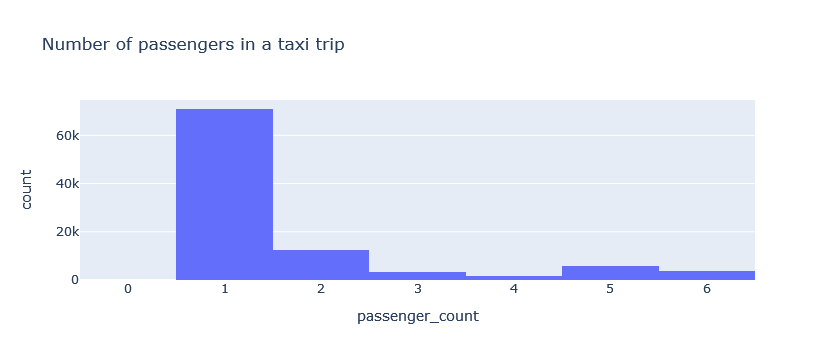

In [44]:
fig = px.histogram(nyctrips, x='passenger_count', title="Number of passengers in a taxi trip")
fig.show()

In [32]:
# Percentile distribution of trip_distance (in miles)
nyctrips['trip_distance'].quantile([0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99])

0.05     0.5000
0.10     0.6500
0.25     1.0000
0.50     1.6700
0.75     3.0700
0.90     6.3000
0.95    10.0000
0.99    18.1715
Name: trip_distance, dtype: float64

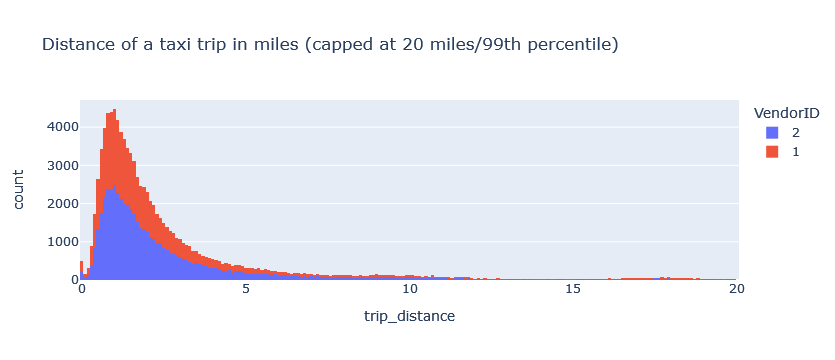

In [48]:
fig = px.histogram(nyctrips[nyctrips['trip_distance']<20],
                   x='trip_distance',
                   color='VendorID',
                   title="Distance of a taxi trip in miles (capped at 20 miles/99th percentile)")
fig.show()

In [31]:
# Percentile distribution of total_amount (in USD)
nyctrips['total_amount'].quantile([0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99])

0.05     5.80
0.10     6.80
0.25     8.30
0.50    11.60
0.75    17.15
0.90    27.80
0.95    42.15
0.99    69.60
Name: total_amount, dtype: float64

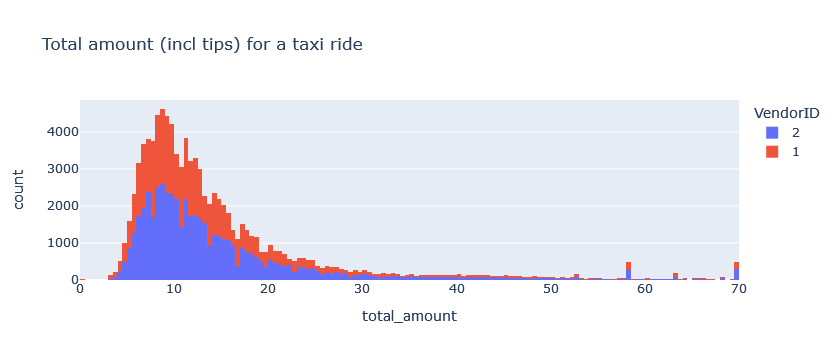

In [49]:
fig = px.histogram(nyctrips[(nyctrips['total_amount'] < 70) & (nyctrips['total_amount'] > 0)],
                   x='total_amount',
                   color='VendorID',
                   title="Total amount (incl tips) for a taxi ride")
fig.show()

In [58]:
# trip duration
nyctrips['duration_mins'] = (nyctrips['tpep_dropoff_datetime'] - nyctrips['tpep_pickup_datetime']).astype('timedelta64[m]')
nyctrips['duration_mins'].quantile([0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99])

0.05     3.0
0.10     4.0
0.25     6.0
0.50    10.0
0.75    16.0
0.90    25.0
0.95    32.0
0.99    55.0
Name: duration_mins, dtype: float64

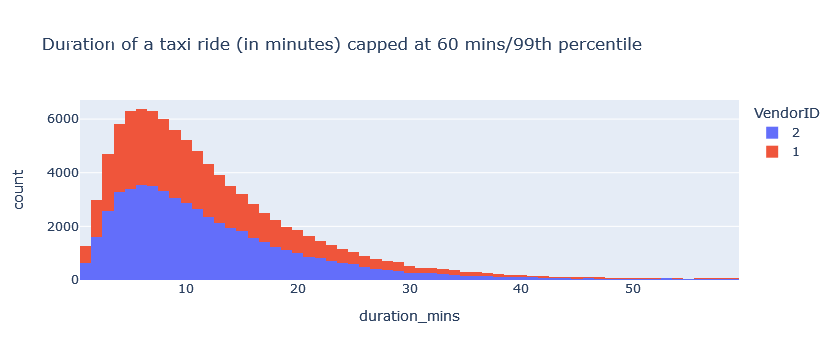

In [66]:
fig = px.histogram(nyctrips[(nyctrips['duration_mins'] < 60) & (nyctrips['duration_mins'] > 0)],
                   x='duration_mins',
                   color='VendorID',
                   title="Duration of a taxi ride (in minutes) capped at 60 mins/99th percentile")
fig.show()

In [69]:
# busy pickup times during the day
nyctrips['pickup_hour'] = nyctrips['tpep_pickup_datetime'].dt.hour
nyctrips['pickup_hour'].quantile([0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99])

0.05     1.0
0.10     6.0
0.25     9.0
0.50    15.0
0.75    20.0
0.90    22.0
0.95    23.0
0.99    23.0
Name: pickup_hour, dtype: float64

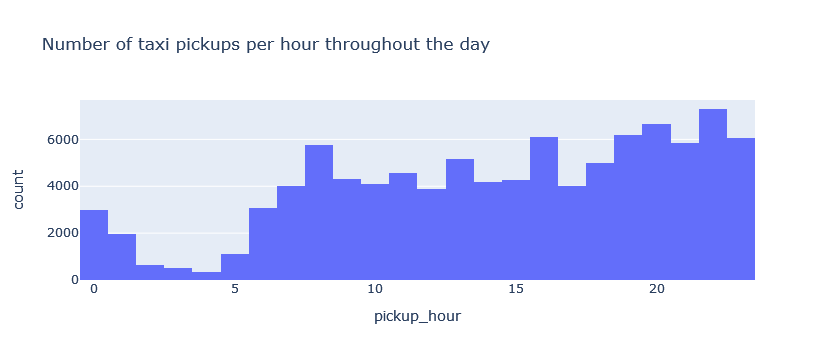

In [74]:
fig = px.histogram(nyctrips,
                   x='pickup_hour',
                   title="Number of taxi pickups per hour throughout the day")
fig.show()

**Findings:**
- Majority of taxi trips (72%) have only 1 passenger. Only about 10% of taxi trips have 4 or more passengers
- 25% of the taxi trips cover a distance of 1 mile or less. 75% cover 3 miles or less. Only about 10% are longer than 10 miles  
- About half of the taxi trips last 10 minutes or less. Only about 10% of the total trips are longer than 25 minutes  
- Evening hours (7 pm to midnight) are the busiest for taxi pickups, with 10-11 pm being the busiest with ~7.3K pickups. During daytime, 8 am and 4 pm see a considerable rush of taxi trip pickups
- There is no difference in the patterns between the two vendors in the data (seen in blue and red in the above graphs)

**NYC Inspections**

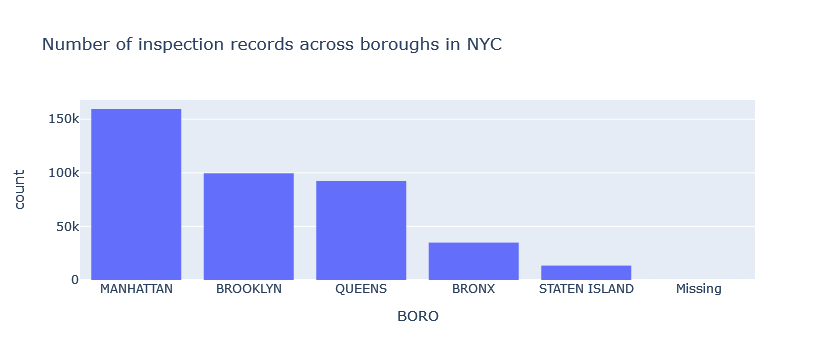

In [84]:
fig = px.histogram(nycinspections,
                   x='BORO',
                   title="Number of inspection records across boroughs in NYC",).update_xaxes(categoryorder='total descending')
fig.show()

In [93]:
count_of_restaurants = nycinspections.groupby(['BORO']).agg({'CAMIS': 'nunique'}).reset_index().sort_values('CAMIS', ascending=False)
# total number of restaurants
count_of_restaurants['CAMIS'].sum()

26505

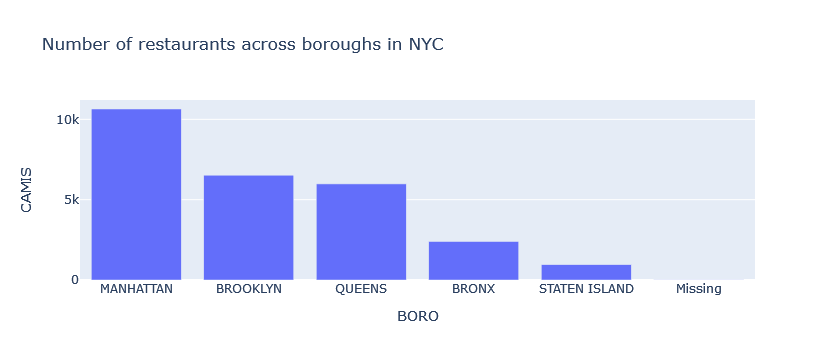

In [90]:
fig = px.bar(count_of_restaurants,
             x='BORO',
             y='CAMIS',
             title="Number of restaurants across boroughs in NYC",)
fig.show()

**Findings:**
- Manhattan has the most number of restaurants (>40% of the total 26.5K restaurants in the NYC Inspections data), followed by Brooklyn and Queens. The number of inspection records follow the same order

## Linking datasets spatially

1. Geocode restaurant addresses to get their lat, long coordinates
1. Add lunchtime (11.30 am to 2 pm), dinnertime (5 pm to 9 pm) labels to NYC Trips data based on dropoff times

In [303]:
# Get lat, lng coordinates for restaurant addresses using Google Geocoding API

def geocode_address(inp_address, api_key):
    """
    Converts the address string to lat, lon coordinates, given API key for google cloud
    """
    geocode_url = "https://maps.googleapis.com/maps/api/geocode/json"

    # address = building + street + zip
    url_encoded_address = inp_address
    # url_encoded_address = requests.utils.quote(inp_address)
    
    payload = {'address': url_encoded_address,
               'key': api_key,
               'region': 'US'}

    r = requests.get(geocode_url, params=payload)
    # print(r.url)
    
    if r.status_code == 200:
        # print(response.text)
        r_json = r.json()
        address_str = r_json['results'][0]['formatted_address']
        address_lat_lon = r_json['results'][0]['geometry']['location']
        return address_str, address_lat_lon

# read API key
with open("./secret/gcloud_maps_api_key.txt") as api_file:
    api_key = api_file.read()

# address_str, address_lat_lon = geocode_address('635 second avenue 10016', api_key)
# print(address_str, address_lat_lon)

In [305]:
# get unique restaurants
nyc_restaurants = nycinspections[['CAMIS', 'DBA', 'BORO', 'BUILDING', 'STREET', 'ZIPCODE', 'CUISINE DESCRIPTION']].drop_duplicates(ignore_index=True)
print(nyc_restaurants.shape)

# drop restaurants with NA addresses
nyc_restaurants.dropna(axis=0, subset=['BUILDING', 'STREET', 'ZIPCODE'], inplace=True)
print(nyc_restaurants.shape)

(26505, 7)
(26485, 7)


In [306]:
# create an address column with 'NY' string added for a more accurate Geocoding
nyc_restaurants['ADDRESS'] = nyc_restaurants['BUILDING'] + ' ' + nyc_restaurants['STREET'] + ' NY ' + nyc_restaurants['ZIPCODE'].astype('int').astype('str')

In [321]:
# Run geocoding for all restaurants - 26.5K  sequential requests to Geocoding API
# nyc_restaurants['address_lat_lng'] = nyc_restaurants.apply(lambda row: geocode_address(row['ADDRESS'], api_key), axis=1)

In [322]:
# save geocoding results
# nyc_restaurants.to_csv("./nyc_restaurants_lat_lng_geocoding_result.csv", index=False)

In [311]:
nyc_restaurants['geo_address'] = nyc_restaurants.apply(lambda row: row['address_lat_lng'][0], axis=1)
nyc_restaurants['lat'] = nyc_restaurants.apply(lambda row: row['address_lat_lng'][1]['lat'], axis=1)
nyc_restaurants['lng'] = nyc_restaurants.apply(lambda row: row['address_lat_lng'][1]['lng'], axis=1)

# remove redundant column
nyc_restaurants = nyc_restaurants.drop("address_lat_lng", axis=1)

In [319]:
nyc_restaurants[:3]

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,CUISINE DESCRIPTION,ADDRESS,geo_address,lat,lng
0,40511702,NOTARO RESTAURANT,MANHATTAN,635,SECOND AVENUE,10016.0,Italian,635 SECOND AVENUE NY 10016,"635 2nd Ave, New York, NY 10016, USA",40.745295,-73.975777
1,50046354,VITE BAR,QUEENS,2507,BROADWAY,11106.0,Italian,2507 BROADWAY NY 11106,"2507 Broadway, New York, NY 10025, USA",40.793126,-73.973306
2,50061389,TACK'S CHINESE TAKE OUT,STATEN ISLAND,11C,HOLDEN BLVD,10314.0,Chinese,11C HOLDEN BLVD NY 10314,"11 Holden Blvd, Staten Island, NY 10314, USA",40.604667,-74.121197
